In [1]:
# interactive backend (zoom, pan, update plot)
# %matplotlib notebook 

# static backend (VS Code default, this one always prints the last frame)
# %matplotlib inline 

import numpy as np
import matplotlib.pyplot as plt

from run_gather import execute_simulation
from simulation import create_coupling_matrix
from plotting import animate_grid, plot_grid
from util import parse_metadata, get_t_eval_from_filename

import datetime
date = datetime.datetime.now().strftime("%Y-%m-%d")
# date = '2023-04-20'

# Simulation Example

In [2]:
filename = 'example_simulation'
params = dict(
    output=filename,
    temperature=1.0,
    num_points=100,
    num_eval=100,
    timestep=0.1,
    parallel=False,
    num_procs=None,
    skip_prompt=True,
    dtype='float32',
    coupling_radius=3,
    coupling_sum=None,
    init=None,
    verbose=True,
    log=False,
    overwrite_old_file=True,
)

In [3]:
execute_simulation(**params)

setting up grid and simulation...
running serial simulation using 1 process...


757913: 100%|██████████| 100/100 [00:00<00:00, 283.28it/s]

finished! total time: 0.36 seconds
saving results to data/2023-04-20/example_simulation.npy ...
done!


In [4]:
results = np.load(f'data/{date}/{filename}.npy')
t_eval = get_t_eval_from_filename(f'data/{date}/{filename}.npy')

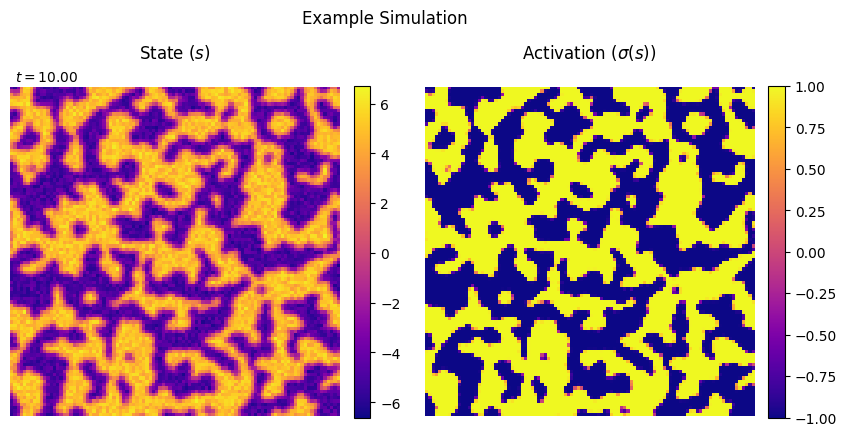

In [5]:
%matplotlib inline 
fig, ax, artists = plot_grid(results, time=t_eval, title='Example Simulation')

In [6]:
%matplotlib notebook 
animate_grid(results, time=t_eval, plot_every=2, title='Example Simulation')

<IPython.core.display.Javascript object>

# Some parameter sweeps to investigate the effect of different parameters in small scale simulations

In [7]:
default_params = dict(
    output=None,
    temperature=1.0,
    num_points=100,
    num_eval=200,
    timestep=0.1,
    parallel=False,
    num_procs=None,
    skip_prompt=True,
    dtype='float32',
    coupling_radius=3,
    coupling_sum=None,
    init=None,
    verbose=False,
    log=False,
    seed=1234567890, # 1234567890 - ensure same starting state when comparing
    print_tqdm=False,
)

## Temperature

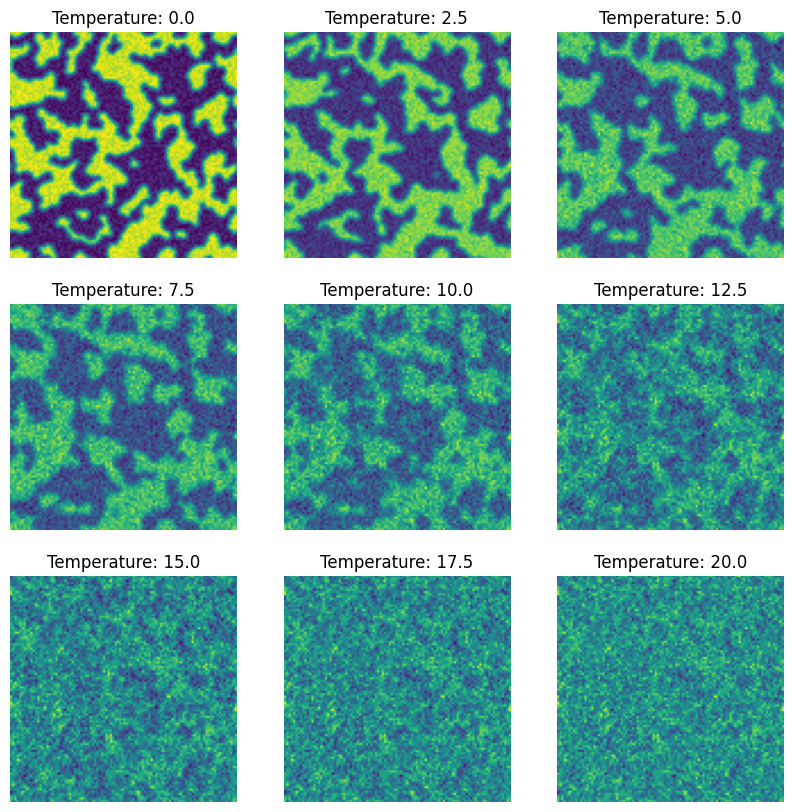

In [8]:
temperatures = np.linspace(0, 20, 9)

temp_dict = {}

for i, temperature in enumerate(temperatures):
    params = default_params.copy()
    params['temperature'] = temperature
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    temp_dict[temperature] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (temperature, frame) in enumerate(temp_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Temperature: {temperature}')
    ax.axis('off')

plt.show()

## Coupling Radius

In [9]:
# first, test whether the sum of the coupling matrix stays constant when we vary the radius
radii = [3+2*i for i in range(9)]

kernels = [create_coupling_matrix(radius, dtype='float32', norm=None) for radius in radii]
coupling_sums = [np.sum(kernel) for kernel in kernels]

print(coupling_sums)

[4.89764, 6.168925, 6.2797847, 6.283148, 6.283186, 6.2831855, 6.283186, 6.283185, 6.283186]


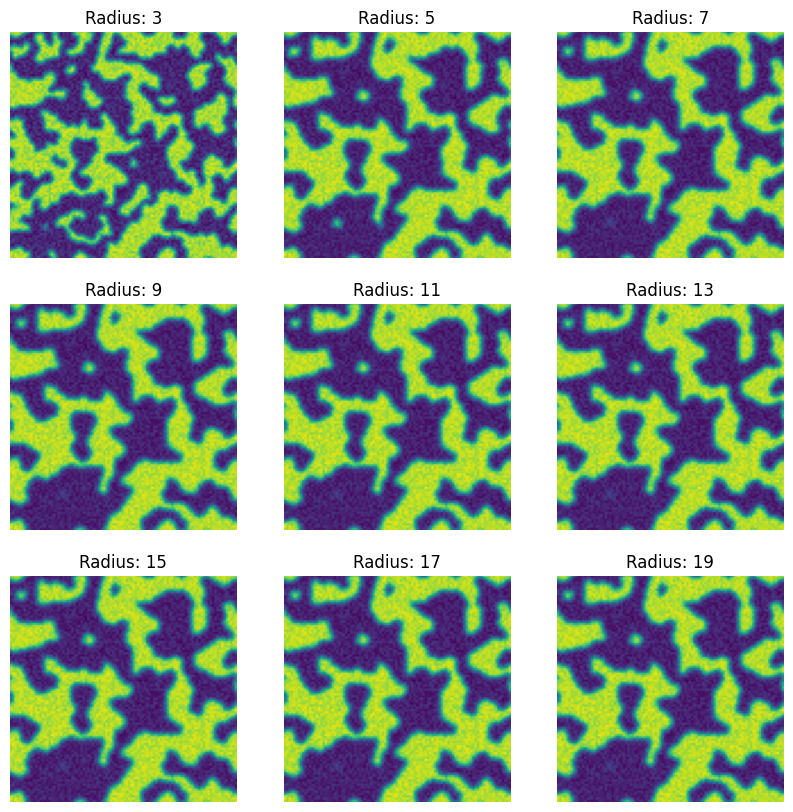

In [10]:
# this result makes sense because the coupling matrix is a gaussian kernel with a fixed standard deviation
# as we increase the radius, the sum converges on the area under the curve
# let's test this anyway, but we will likely converge on long range order, so we will likely need to increase T later

radius_dict = {}

for i, radius in enumerate(radii):
    params = default_params.copy()
    params['coupling_radius'] = radius
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    radius_dict[radius] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (radius, frame) in enumerate(radius_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Radius: {radius}')
    ax.axis('off')

plt.show()

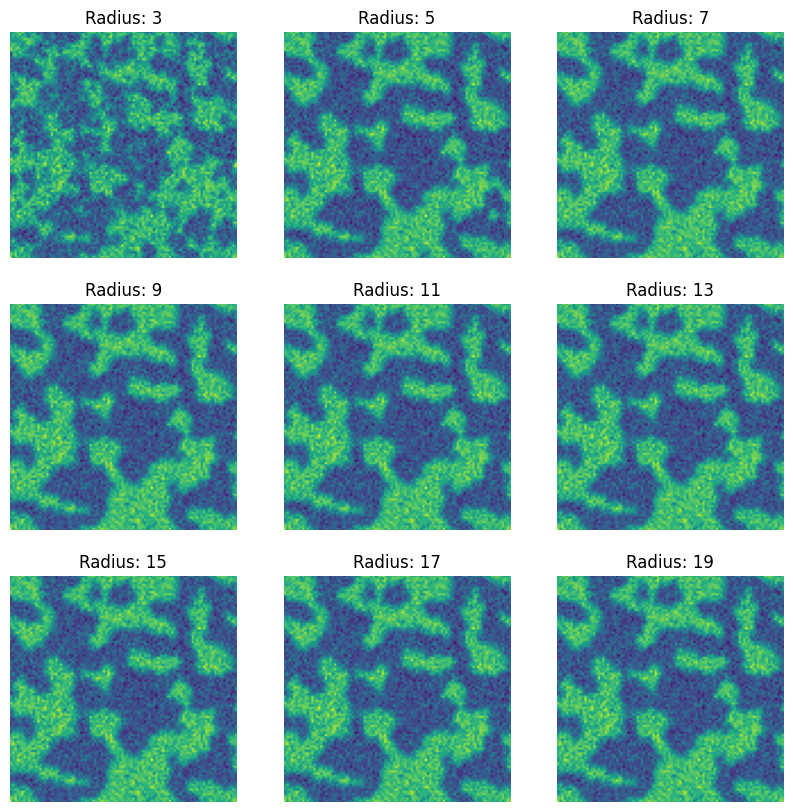

In [11]:
# testing with higher T
radius_dict = {}

for i, radius in enumerate(radii):
    params = default_params.copy()
    params['temperature'] = 10.0
    params['coupling_radius'] = radius
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    radius_dict[radius] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (radius, frame) in enumerate(radius_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Radius: {radius}')
    ax.axis('off')

plt.show()

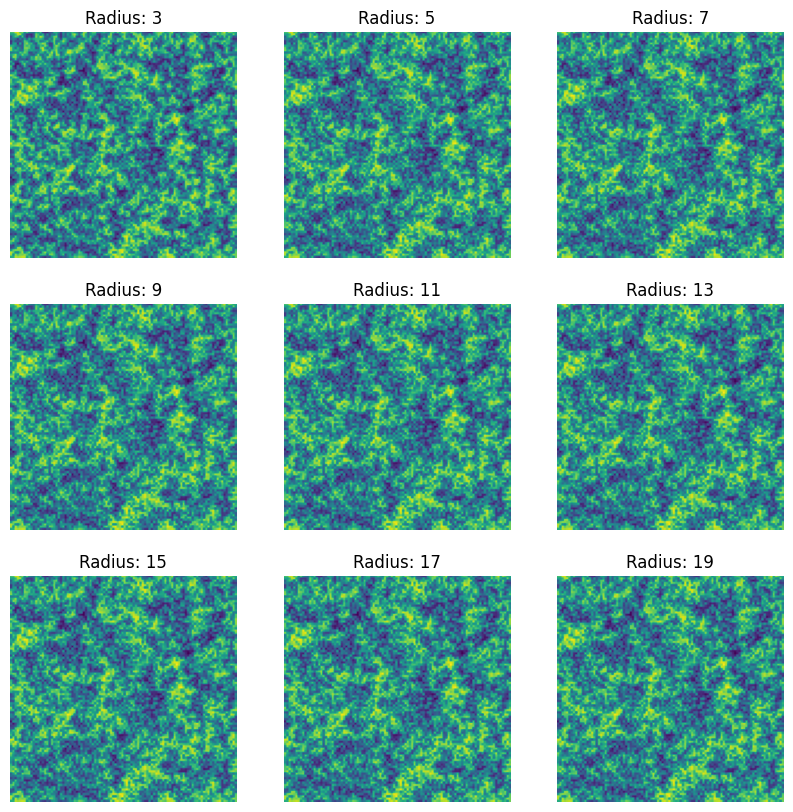

In [12]:
# now let's vary the radius in the same way while holding the coupling sum constant near 1.0
radius_dict = {}

for i, radius in enumerate(radii):
    params = default_params.copy()
    params['temperature'] = 0 # with such a low coupling sum, this state will be completely disordered
    params['coupling_sum'] = 1.25
    params['coupling_radius'] = radius
    params['num_eval'] = 1000 # are we near a critical point? let's run for a long time to see
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    radius_dict[radius] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (radius, frame) in enumerate(radius_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Radius: {radius}')
    ax.axis('off')

plt.show()

It's safe to say from this analysis that coupling radius is not as good of a control parameter as either temperature and coupling strength. Not worth investigating this too much more.

## Coupling Strength

### Sweep [0.5, 2.0]

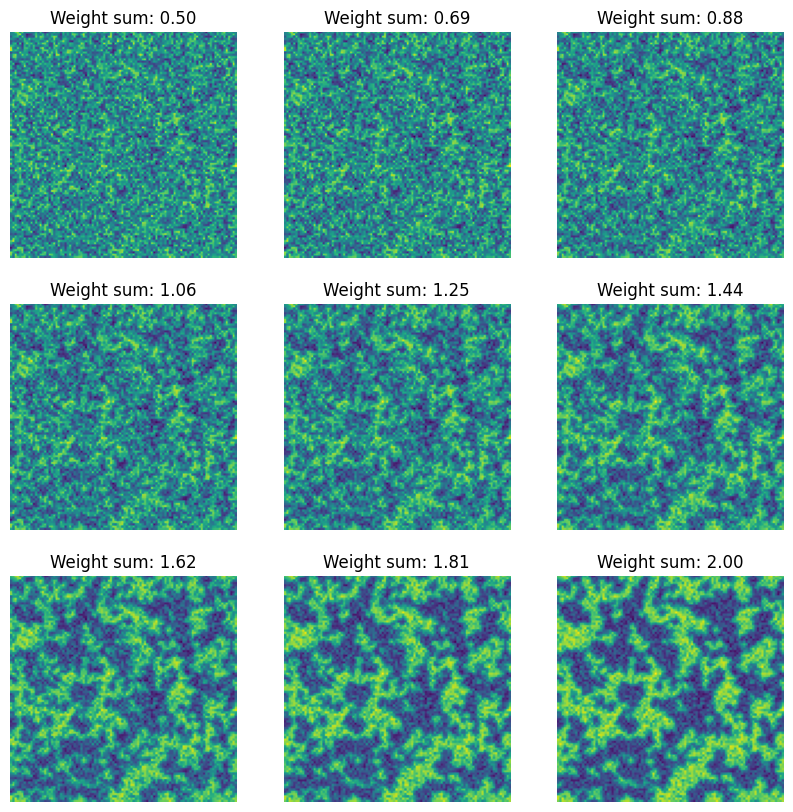

In [13]:
strengths = np.linspace(0.5, 2, 9)

strength_dict = {}

for i, strength in enumerate(strengths):
    params = default_params.copy()
    params['coupling_sum'] = strength
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    strength_dict[strength] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (strength, frame) in enumerate(strength_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Weight sum: {strength:.2f}')
    ax.axis('off')

plt.show()

### Sweep [-2, 2]

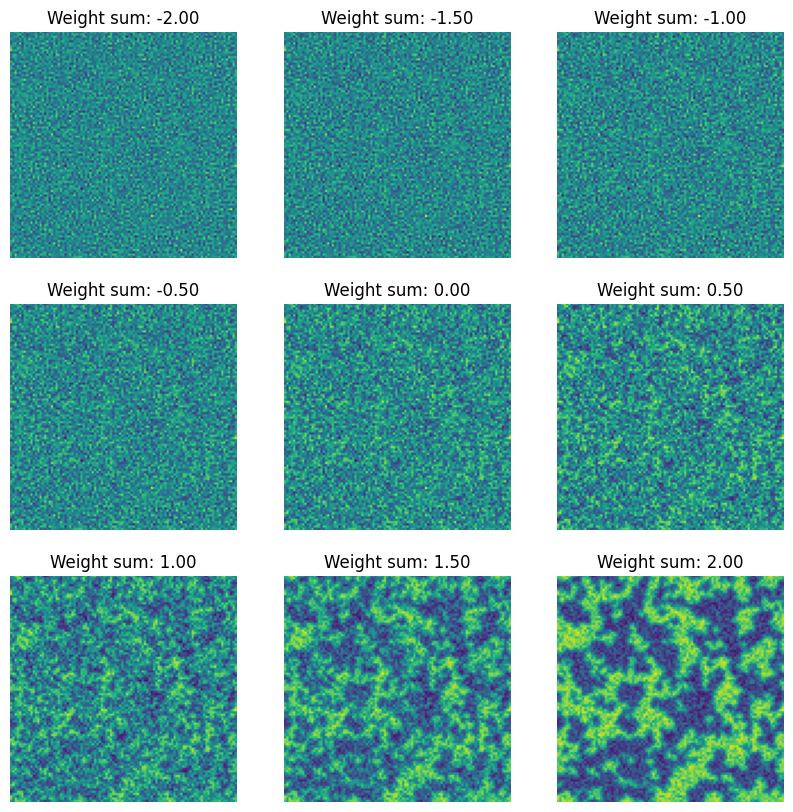

In [14]:
# is weighting symmetric about around 0?
strengths = np.linspace(-2, 2, 9)

strength_dict = {}

for i, strength in enumerate(strengths):
    params = default_params.copy()
    params['coupling_sum'] = strength
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    strength_dict[strength] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (strength, frame) in enumerate(strength_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Weight sum: {strength:.2f}')
    ax.axis('off')

plt.show()


### Matrix Investigation

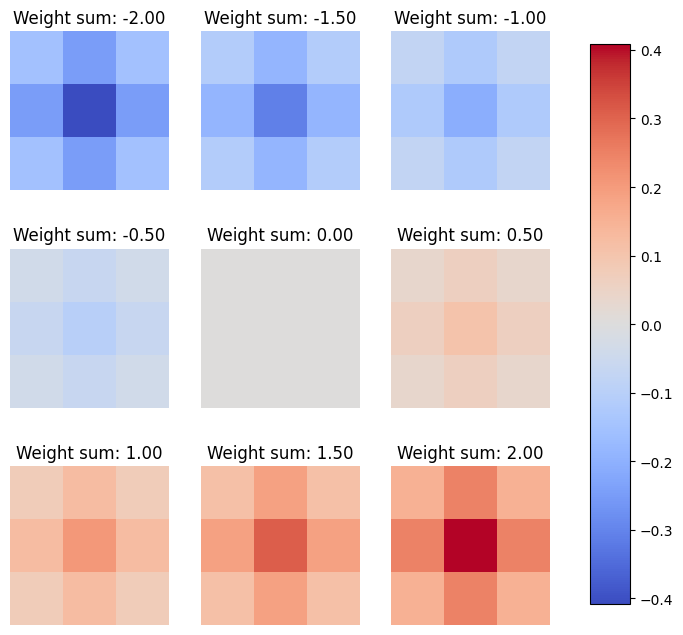

In [15]:
# I didn't expect this... let's plot the coupling matrix for each of these cases

matrix_dict = {}

for i, strength in enumerate(strengths):
    matrix = create_coupling_matrix(3, dtype='float32', norm=strength)
    matrix_dict[strength] = matrix

# make a 3x3 grid of image plots of the final matrices
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(8, 8))

# now plot using one range for all of the subplots
vmin = np.min([np.min(matrix) for matrix in matrix_dict.values()])
vmax = np.max([np.max(matrix) for matrix in matrix_dict.values()])

for i, (strength, matrix) in enumerate(matrix_dict.items()):
    ax = axes[i // 3, i % 3]
    im = ax.imshow(matrix, cmap='coolwarm', vmin=vmin, vmax=vmax)
    ax.set_title(f'Weight sum: {strength:.2f}')
    ax.axis('off')

# put a colorbar on the right side of the plot
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])

# add the color bar with the correct range
fig.colorbar(im, cax=cbar_ax)


I wonder why the system is asymmetric when it comes to coupling weights. The whole system really should be symmetric with respect to 0. Now I wonder what will happen in the case of a difference in positive/negative weights for recurrent connections versus lateral connections. Let's come up with a custom weight matrix to do this.

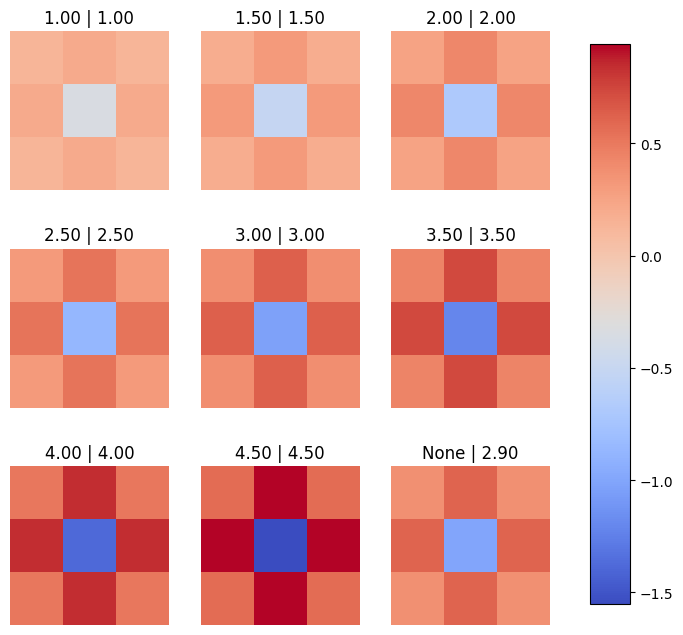

In [16]:
matrix_dict = {}
strengths = [1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 4.5, None]

for i, strength in enumerate(strengths):
    matrix = create_coupling_matrix(3, dtype='float32', norm=strength, inhibitory=True)
    matrix_dict[strength] = matrix

# make a 3x3 grid of image plots of the final matrices
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(8, 8))

# now plot using one range for all of the subplots
vmin = np.min([np.min(matrix) for matrix in matrix_dict.values()])
vmax = np.max([np.max(matrix) for matrix in matrix_dict.values()])

for i, (strength, matrix) in enumerate(matrix_dict.items()):
    ax = axes[i // 3, i % 3]
    im = ax.imshow(matrix, cmap='coolwarm', vmin=vmin, vmax=vmax)
    if strength is not None:
        title=f'{strength:.2f} | {np.sum(matrix):.2f}'
    else:
        title=f'None | {np.sum(matrix):.2f}'
    ax.set_title(title)
    ax.axis('off')

# put a colorbar on the right side of the plot
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])

# add the color bar with the correct range
fig.colorbar(im, cax=cbar_ax)


### Sweep [0.5, 2.0] (Self-inhibition)

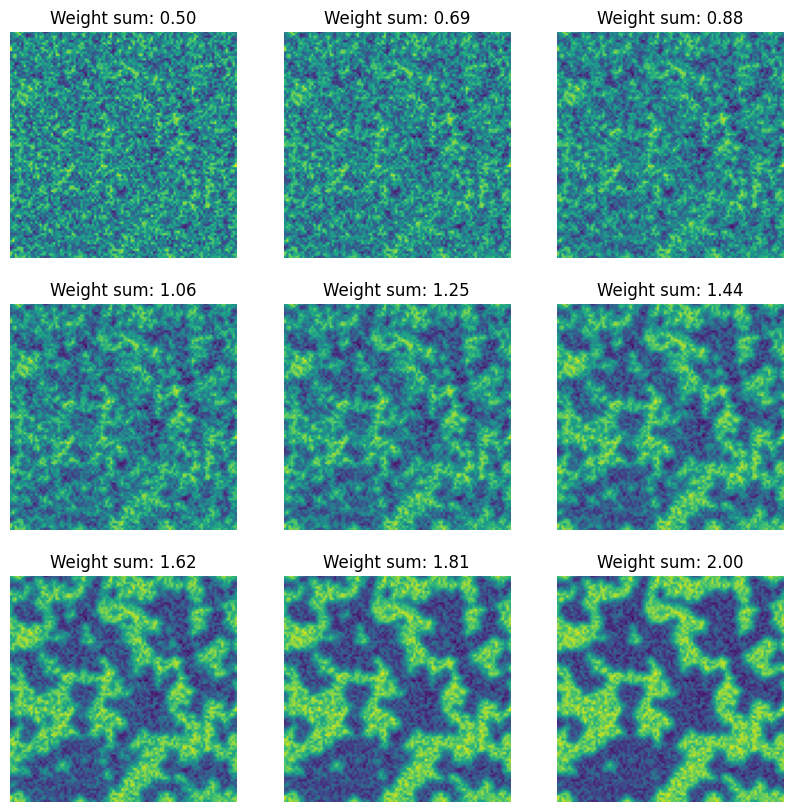

In [17]:
strengths = np.linspace(0.5, 2, 9)

strength_dict = {}

for i, strength in enumerate(strengths):
    params = default_params.copy()
    params['coupling_sum'] = strength
    params['inhibitory'] = True
    results,_ = execute_simulation(**params)
    final_frame = results[-1]
    strength_dict[strength] = final_frame

# make a 3x3 grid of image plots of the final frames
%matplotlib inline
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

for i, (strength, frame) in enumerate(strength_dict.items()):
    ax = axes[i // 3, i % 3]
    ax.imshow(frame, cmap='viridis')
    ax.set_title(f'Weight sum: {strength:.2f}')
    ax.axis('off')

plt.show()

In [18]:
# let's use the same parameters as above but animate this time, are there qualitative differences?
%matplotlib notebook 

strengths = np.linspace(0.5, 2, 9)
strength_dict = {}
for i, strength in enumerate(strengths):
    params = default_params.copy()
    params['coupling_sum'] = strength
    params['inhibitory'] = True
    results,t_eval = execute_simulation(**params)
    anim = animate_grid(results, time=t_eval, plot_every=2, title=f'Weight sum: {strength:.2f}')
    strength_dict[strength] = anim

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [19]:
strength_dict[strengths[-1]]

In [21]:
params = default_params.copy()
params['coupling_sum'] = 2.0
params['inhibitory'] = False
results,t_eval = execute_simulation(**params)
animate_grid(results, time=t_eval, plot_every=2, title=f'Weight sum: 2.0')

<IPython.core.display.Javascript object>